#### Each RAS plan simulation output WSE for each point in ./data/points.geojson has been processed to a json file in ./data/*.json

This script protypes plots the WSE for each point in the json file in a single plot. The protype will then be ported to the Javascript map.js, where a sidebar will be added to plot the WSE for each event for all points.

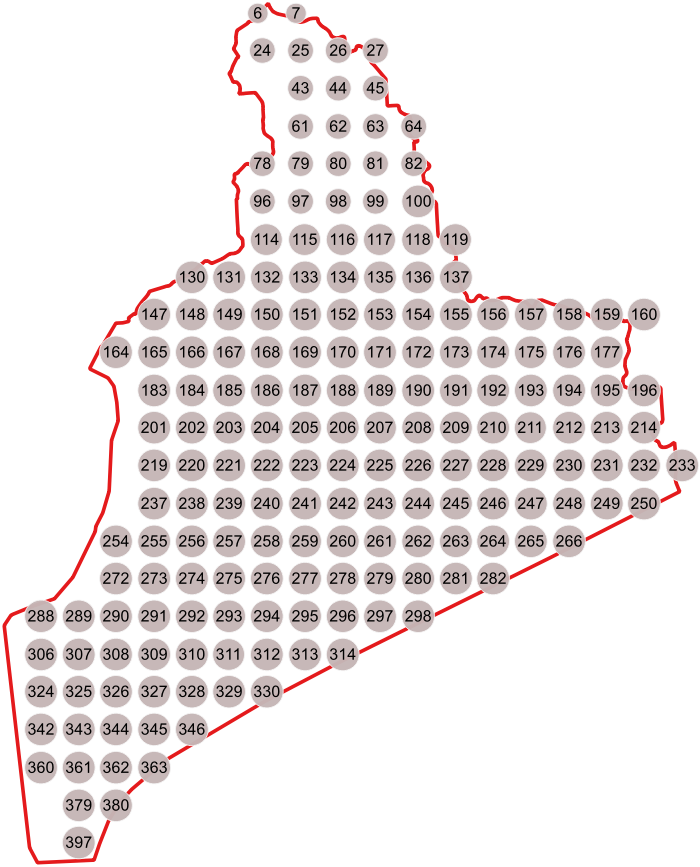

In [4]:
# For each event json, plot all points
import glob, os, json
import geopandas as gpd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from PIL import Image

img = Image.open("../data/basin_points.png")
img

In [5]:

# Get point Ids from points.geojson
qaqc_points = gpd.read_file('../data/points.geojson')
qaqc_pointIDs = qaqc_points['id'].values

In [7]:
# Get event WSE timeseries *.json files from ./output
wse_json_files = glob.glob('../output/*.json')
wse_json = json.load(open(wse_json_files[0], 'r'))
# wse_json['pointData']
wse_json['planName']

'010yr Atlas 14'

In [ ]:
# Plot all points
pt_fig = make_subplots(rows=2, cols=1, subplot_titles=["WSE", ""], #vertical_spacing=1, horizontal_spacing=1
                           )
for i, qaqc_point_data in enumerate(wse_json['pointData']):
    # open each json file and get the wse for the qaqc_point and add it the subplot for the point.
    pt_fig.add_trace(go.Scatter(
    x=wse_json['datetime'], y=qaqc_point_data['wse'],
    hovertext=qaqc_point_data['qaqc_pointID'], hoverinfo="text",
    # marker=dict(
    #     color="blue"
    # ),
    showlegend=True, name=qaqc_point_data['qaqc_pointID'],
    mode='lines'), row=1, col=1)
    # ))
    # Add seond trace thats empty to add the image to the subplot
    pt_fig.add_trace(go.Scatter(
        x=None, y=None, hovertext=None, showlegend=False, mode='lines'), row=2, col=1, )
    pt_fig.update_layout(
        height=3000, width=1000, 
        title_text=f"{wse_json['planName']} WSE for all points.",
        hovermode="x unified",
        xaxis2=dict(showticklabels=False, showgrid=False, zeroline=False, fixedrange=True),
        yaxis2=dict(showticklabels=False, showgrid=False, zeroline=False),
        yaxis_domain = [.7,1],
        yaxis2_domain = [0, .58],
        xaxis_domain = [0, 1],
        xaxis2_domain = [0, .445],
    )

pt_fig.add_layout_image(
        row=2,
        col=1,
        source=img,
        xref="paper", yref="paper",
        x=-1, y=-1,
        xanchor="left",
        yanchor="bottom",
        sizex=10,
        sizey=5,
        sizing="contain",
        layer="above",

    )

# export point figure
# pt_fig.update_layout(height=1500, width=1700, title_text=f"WSE for all events at point {qaqc_point}")
# pt_fig.write_html(f'../output/figs/events/{wse_json['planName']}.html')
pt_fig.show()

In [98]:
x_markers = []
y_markers = []
hover_text = []
for i, event_json in enumerate(wse_json_files):
    event = json.load(open(event_json, 'r'))
    for point in event['pointData']:
        point['max_wse'] = max(point['wse'])
        y_markers.append(round(max(point['wse']),2))
        x_markers.append(event['planName'])
        hover_text.append(point['qaqc_pointID'])

In [106]:
# Plot all points
max_fig = make_subplots(rows=2, cols=1, subplot_titles=["Max WSE", ""]) #vertical_spacing=1, horizontal_spacing=1
                        
max_fig.add_trace(go.Scatter(
    x=x_markers, y=y_markers,
    hovertext=hover_text, hoverinfo="text",
    # marker=dict(
    #     color="blue"
    # ),
    showlegend=False, name='max_wse',
    mode='markers'), row=1, col=1)

max_fig.update_layout(
        height=3000, width=1000, 
        # title_text=f"{wse_json['planName']} WSE for all points.",
        # hovermode="y unified",
        # xaxis2=dict(showticklabels=False, showgrid=False, zeroline=False, fixedrange=True),
        # yaxis2=dict(showticklabels=False, showgrid=False, zeroline=False),
        # yaxis_domain = [.7,1],
        # yaxis2_domain = [0, .58],
        # xaxis_domain = [0, 1],
        # xaxis2_domain = [0, .445],
    )

max_fig.add_layout_image(
        row=2,
        col=1,
        source=img,
        xref="paper", yref="paper",
        x=-1, y=-1,
        xanchor="left",
        yanchor="bottom",
        sizex=10,
        sizey=5,
        sizing="contain",
        layer="above",

    )


In [107]:
# export max figure to html
max_fig.write_html(f'../max_wse.html')

In [85]:
# Plot all points
max_fig = make_subplots(rows=2, cols=1, subplot_titles=["WSE", ""], #vertical_spacing=1, horizontal_spacing=1
                           )
for i, qaqc_point_data in enumerate(wse_json['pointData']):
    # open each json file and get the wse for the qaqc_point and add it the subplot for the point.
    max_fig.add_trace(go.Scatter(
    x=wse_json['datetime'], y=qaqc_point_data['wse'],
    hovertext=qaqc_point_data['qaqc_pointID'], hoverinfo="text",
    # marker=dict(
    #     color="blue"
    # ),
    showlegend=True, name=qaqc_point_data['qaqc_pointID'],
    mode='lines'), row=1, col=1)

In [73]:
# Max values for each point in the event
max_wse_dict = {
    # event:
    # [qaqc_pointID: max_point_wse]
}

for event in wse_json_files:
    event_json = json.load(open(event, 'r'))
    plan_name = event_json['planName']
    for i, qaqc_point_data in enumerate(event_json['pointData']):
        # print(qaqc_point_data['qaqc_pointID'])
        # get max value of each point
        max_point_wse = {
            "point": qaqc_point_data['qaqc_pointID'],
             "max_wse": max(qaqc_point_data['wse'])
            }
        # add max value to dict
        max_wse_dict[plan_name] = []
        max_wse_dict[plan_name].append(max_point_wse)

In [74]:
[max_wse_dict[k]['max_wse'] for k in max_wse_dict]

TypeError: list indices must be integers or slices, not str

In [70]:
for event in max_wse_dict:
    for point in max_wse_dict[event]:
        print (point)

point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse
point
max_wse


In [65]:
max_fig = make_subplots(rows=2, cols=1, subplot_titles=["Max WSE", ""])
max_fig.add_trace(go.Scatter(
    x=event,y=[max_wse_dict[k]['max_wse'] for k in max_wse_dict]))
    # x=event, y=qaqc_point_data['wse'],
    # hovertext=qaqc_point_data['qaqc_pointID'], hoverinfo="text",
    # # marker=dict(
    # #     color="blue"
    # # ),
    # showlegend=True, name=qaqc_point_data['qaqc_pointID'],
    # mode='lines'), row=1, col=1)

ValueError: 
    Invalid value of type 'builtins.str' received for the 'x' property of scatter
        Received value: '010yr Atlas 14'

    The 'x' property is an array that may be specified as a tuple,
    list, numpy array, or pandas Series